In [2]:
import overpy
import pandas as pd
import networkx as nx
from networkx.algorithms.shortest_paths.generic import shortest_path
import matplotlib.pyplot as plt
from postman_problems.solver import cpp

In [3]:
api = overpy.Overpass()

In [3]:
result = api.query("[out:json];node(50.745,7.17,50.75,7.18);out;")

In [4]:
mountview_query = '''((way[highway~"^(residential)$"]
  (43.23407,-79.92975,43.24457,-79.9156);
- way(id:35293308,
                 441472728,
                 441472731,
                 465328794,
      100763472,
      184336259,
      184336260,
      35292044,
      35291798,
      35295208,
      35292558,
     27726852);

                 );

way(id:100763473);
                 );

out body;
>;
out skel qt;'''
mountview_starting_node = 210842205

In [5]:
iroquois_height_query = '''((way[highway~"(path|footway)"](43.2354, -79.9481, 43.2458, -79.9342);
-
 way(id:50525780);
);
way(id:281458431);
);
out body;
>;
out skel qt;'''
iroquois_starting_node = 4959344315

In [6]:
dvca_query = '''((way[highway~"(path|footway)"](43.2166, -80.0342,43.2571, -79.9454);

way(id:148998895,178208755,23842147,194434747,179780233,248315310); 
 
);
 - way(id:194434747);
);
out body;
>;
out skel qt;'''
dvca_starting_node =244444276

In [7]:
sir_allen_query = '''((way[highway~"(residential)"](43.2262, -79.93,43.2335, -79.9142);
 
 - way(id:318893169,35296504, 35288783,35300998,35290726,669410986,100763937,100763929,100763930, 100763933,100763931,100763928,100763935,100763932,35294317,35294247,35298278, 487972246,35298871,262613530,35298648,35291752,35296616
);

);
 way(id:28284428,100763855,448424152,262613551,459926739);
 );
 
out body;
>;
out skel qt;
'''
sir_all_starting_point = 35195047

In [8]:
west_query = '''((way[highway~"(residential|secondary)"](43.2308,  -79.9167,43.24585, -79.8989);
 
 - way(id:27828859,465327308,20879447,262613551,459926739,28284409,435213738,511322002,511322001,54740356,435213737,435213731,435213735,465327305,299675993,27925282,54738917
);

);
 way(id:20252436,20252469,438189804,299675995,465664297);
 );
 
out body;
>;
out skel qt;'''
west_starting_point = 224348259

In [ ]:
west_query_wip = '''way(poly:"43.2338833 -79.9172977 43.2384040 -79.9157607 43.2426547 -79.9145072 43.2455525 -79.9119351 43.2440043 -79.9063297 43.2348644 -79.9100741 43.2352120 -79.9131847 43.2337269 -79.9152820 43.2338915 -79.9172487 43.2338929 -79.9174887 43.2338929 -79.917553143.2338929 -79.9174887")[highway~"(residential|secondary)"];
 
out body;
>;
out skel qt;'''

In [12]:
gurnett_query = """way(poly:"43.22112 -79.92948 43.21873 -79.91867 43.22583 -79.91551 43.22900 -79.92989")[highway~"(residential|secondary)"];
 
out body;
>;
out skel qt;"""
gurnett_start = 299182061

In [21]:
west1_query = """(way(poly:"43.23570 -79.91603 43.24570 -79.91225 43.24495 -79.90701 43.23510 -79.91139")[highway~"(residential|secondary)"];
 
- way(id:465328794);
 );
out body;
>;
out skel qt;"""
west1_start = 224348259

In [23]:
mount2_query = '''((way(poly:"43.23448 -79.91603 43.24192 -79.91444 43.24261 -79.91693 43.24123 -79.92495 43.23792 -79.92615 43.23685 -79.92397 43.23445 -79.92319")[highway~"(residential|secondary)"];
 way(100763473););
- way(id:465327309,27726852,35292044,35291798,35295208,35292558,100763558,100763548);
 );
out body;
>;
out skel qt;
'''

mount2_start = 1164614493

In [13]:
from haversine import haversine
from collections import defaultdict
def compute_road_length(road_nodes):
    total_distance = 0
    for i in range(len(road_nodes) - 1):
        n1 = road_nodes[i]
        n2 = road_nodes[i+1]
        total_distance += haversine((n1.lat, n1.lon), (n2.lat, n2.lon))
    return total_distance

def get_node_to_ways_map(ways):
    node_to_ways = defaultdict(list)
    for way_id, way in ways.items():
        for node in way.nodes:
            node_to_ways[node.id].append(way_id)
    return node_to_ways

def get_way_segments(ways, intersections):
    way_segments = dict()
    
    dead_ends = dict()
    #print('getting_way_segments for:')
    for way_id, way in ways.items():

        #print(way_id)
        #print('way_id', way_id)
        first_node_id = way.nodes[0].id
        last_node_id = way.nodes[-1].id
        print('way_id:{} first_id:{} last_id:{}'.format(way_id, first_node_id, last_node_id))
        if first_node_id not in intersections:
            dead_ends[first_node_id] = way
        if last_node_id not in intersections:
            dead_ends[last_node_id] = way

        current_segment = []
        i = 0
        for node in way.nodes:
            #print('node', node)
            if node.id in dead_ends or node.id in intersections:
                if len(current_segment):
                    current_segment.append(node)
                    way_segments[(way_id, i)] = current_segment
                    current_segment = [node]
                    i += 1
                else:
                    current_segment.append(node)
            else:
                current_segment.append(node)
    print('dead_ends')
    for k, v in dead_ends.items():
        print(k, v.id)
        
    print('way segments')
    for k, v in way_segments.items():
        print(k, [vi.id for vi in v])
    return way_segments


def get_cpp_circuit(query, starting_node):
    result = api.query(query)
    node_map = {node.id: node for node in result.nodes}
    ways = {way.id: way for way in result.ways}
    print('got back {} nodes and {} ways'.format(len(node_map), len(ways)))
    for w in ways.keys():
        print(w)
    node_to_ways = get_node_to_ways_map(ways)
    print('node_to_ways')
    for k, v in sorted(node_to_ways.items()):
        print(k, v)
    intersections = {k for k, v in node_to_ways.items() if len(v) > 1}
    print('intersections')
    for k in sorted(intersections):
        print(k)
    way_segments = get_way_segments(ways, intersections)
        
    node_pair_to_way_segment = {}

    vals = []
    for key, way_segment in way_segments.items():
        sorted_pair = tuple(sorted([way_segment[0].id, way_segment[-1].id]))
        node_pair_to_way_segment[sorted_pair] = way_segment                 
        vals.append({
            'trail': '_'.join([str(s) for s in key]),
            'node1': way_segment[0].id,
            'node2': way_segment[-1].id,
            'lat1': way_segment[0].lat,
            'lon1': way_segment[0].lon,
            'lat2': way_segment[-1].lat,
            'lon2': way_segment[-1].lon,
            'distance':compute_road_length(way_segment)
        })
    df = pd.DataFrame(vals)
    print(df)
    df.to_csv(r'C:\tmp\cpp_df.csv')
    df = remove_unconnected_nodes(df, starting_node)
    print(df)
    
    path = r'C:\tmp\mountview_df.csv'
    export_datapoints(df, path)
    
    circuit, graph = cpp(edgelist_filename=path, 
                         start_node='x_{}'.format(starting_node))
        
        
    distance = sum([c[3]['distance'] for c in circuit])
    print('total_distance:{}'.format(distance))
    circuit_node_ids = [int(x[0][2:]) for x in circuit]
    
    circuit_vals = []
    circuit_nodes = []
    for node_id in circuit_node_ids:
        node = node_map[node_id]
        circuit_nodes.append(node)
        circuit_vals.append({'lat': node.lat,
                            'lon': node.lon})

    circuit_df = pd.DataFrame(circuit_vals)
    for col in ['lat', 'lon']:
        circuit_df[col] = circuit_df[col].astype('float')
        

    
    return circuit_df, circuit, way_segments

In [14]:
def remove_unconnected_nodes(df, starting_node):
    to_remove = []
    G = nx.Graph()
    for i, row in df.iterrows():
        G.add_edge(row['node1'], row['node2'], attr=row['trail'])
    
    for n in G.nodes:
        try:
            x = shortest_path(G, n, starting_node)
        except Exception:
            to_remove.append(n)
    print('removing {} unconnected nodes'.format(len(to_remove)))
    df = df.loc[~df['node1'].isin(to_remove)].loc[~df['node2'].isin(to_remove)]
    return df

In [15]:
def export_datapoints(df, path):
    for col in ['node1', 'node2', 'trail']:
        df[col] = df[col].astype('str')
        
    # the library likes strings
    df['node1'] = df['node1'].apply(lambda x: 'x_{}'.format(x))
    df['node2'] = df['node2'].apply(lambda x: 'x_{}'.format(x))
    df['trail'] = df['trail'].apply(lambda x: 'x_{}'.format(x))
    df[['node1', 'node2', 'trail', 'distance']].to_csv(path, index=False)

In [16]:
import matplotlib.pyplot as plt
import tilemapbase

def draw_circuit(circuit_df, filepath):
    tilemapbase.start_logging()
    tilemapbase.init(create=True)
    
    # Use open street map
    t = tilemapbase.tiles.OSM
    
    delta = 0.002
    min_lat = circuit_df['lat'].min()
    max_lat = circuit_df['lat'].max()
    min_lon = circuit_df['lon'].min()
    max_lon = circuit_df['lon'].max()
    
    extent = tilemapbase.Extent.from_lonlat(min_lon - delta, 
                                            max_lon + delta,
                      min_lat - delta, 
                                            max_lat + delta)
    extent = extent.to_aspect(1.0)
    
    longs = circuit_df['lon'].astype('float').to_list()
    lats = circuit_df['lat'].astype('float').to_list()
    path = [tilemapbase.project(x,y) for x,y in zip(longs, lats)]
    x, y = zip(*path)
    
    fig, ax = plt.subplots(figsize=(40,40))

    plotter = tilemapbase.Plotter(extent, tilemapbase.tiles.OSM, width=1200)
    plotter.plot(ax)
    ax.plot(x, y, "ro", markersize=20)

    i = 1
    unique = set()
    for xi, yi in zip(x, y):
        if (xi, yi) not in unique:
            unique.add((xi, yi))
            plt.annotate(str(i), (xi+.0000003, yi), size=40)
            i += 1
    plt.savefig(filepath, format='jpg')


In [17]:
def plot_nodes_ways(nodes, ways):
    tilemapbase.start_logging()
    tilemapbase.init(create=True)
    
    # Use open street map
    t = tilemapbase.tiles.OSM
    
    delta = 0.002
    min_lat = circuit_df['lat'].min()
    max_lat = circuit_df['lat'].max()
    min_lon = circuit_df['lon'].min()
    max_lon = circuit_df['lon'].max()
    
    extent = tilemapbase.Extent.from_lonlat(min_lon - delta, 
                                            max_lon + delta,
                      min_lat - delta, 
                                            max_lat + delta)
    extent = extent.to_aspect(1.0)
    
    longs = circuit_df['lon'].astype('float').to_list()
    lats = circuit_df['lat'].astype('float').to_list()
    path = [tilemapbase.project(x,y) for x,y in zip(longs, lats)]
    x, y = zip(*path)
    
    fig, ax = plt.subplots(figsize=(40,40))

    plotter = tilemapbase.Plotter(extent, tilemapbase.tiles.OSM, width=1200)
    plotter.plot(ax)
    ax.plot(x, y, "ro", markersize=20)

    i = 1
    unique = set()
    for xi, yi in zip(x, y):
        if (xi, yi) not in unique:
            unique.add((xi, yi))
            plt.annotate(str(i), (xi+.0000003, yi), size=40)
            i += 1
    plt.savefig(filepath, format='jpg')

In [18]:
def generate_gpx(circuit, way_segments, filepath):
    header = '''<?xml version="1.0" encoding="UTF-8"?>
    <gpx creator="StravaGPX" xmlns:xsi="http://www.w3.org/2001/XMLSchema-instance" xsi:schemaLocation="http://www.topografix.com/GPX/1/1 http://www.topografix.com/GPX/1/1/gpx.xsd http://www.garmin.com/xmlschemas/GpxExtensions/v3 http://www.garmin.com/xmlschemas/GpxExtensionsv3.xsd http://www.garmin.com/xmlschemas/TrackPointExtension/v1 http://www.garmin.com/xmlschemas/TrackPointExtensionv1.xsd" version="1.1" xmlns="http://www.topografix.com/GPX/1/1" xmlns:gpxtpx="http://www.garmin.com/xmlschemas/TrackPointExtension/v1" xmlns:gpxx="http://www.garmin.com/xmlschemas/GpxExtensions/v3">
     <metadata>
      <time>{time:%Y-%m-%d}T{time:%H:%M:%S}Z</time>
     </metadata>
     <trk>
      <name>20T with Eric in Toronto</name>
      <type>9</type>
      <trkseg>'''
    
    point_template = '''<trkpt lat="{lat}" lon="{lon}">
    <ele>113.0</ele>
    <time>{time:%Y-%m-%d}T{time:%H:%M:%S}Z</time>
    <extensions>
     <gpxtpx:TrackPointExtension>
      <gpxtpx:hr>95</gpxtpx:hr>
      <gpxtpx:cad>57</gpxtpx:cad>
     </gpxtpx:TrackPointExtension>
    </extensions>
   </trkpt>'''
    
    footer = '''</trkseg>
     </trk>
    </gpx>'''
    
    from datetime import timedelta
    import datetime as dt
    current_time = dt.datetime(2019, 3, 7, 12, 0, 0)

    total_nodes = 0
    gpx_txt = header.format(time=current_time)
    last_node = None
    first_node = None
    for node1, node2, i, seg_dict in circuit:

        trail = seg_dict['trail']
        _, way_id, num = trail.split('_')
        way_id = int(way_id)
        num = int(num)
        #print(way_id)
        nodes = way_segments[(way_id, num)]
        node1_int = int(node1[2:])
        if nodes[0].id != node1_int:
            nodes = reversed(nodes)
        #print(nodes)
        for node in nodes:
            if first_node == None:
                first_node = node
            if node != last_node:
                if last_node != None:
                    length = compute_road_length([last_node, node])
                else:
                    length = None
                last_node = node

                if total_nodes < 20000:
                    #print(length)
                    if length is None or length > 0:
                        total_nodes += 1
                        gpx_txt += point_template.format(lon=node.lon, lat=node.lat,
                                                time = current_time)
            current_time += timedelta(seconds=5)
    gpx_txt += point_template.format(lon=first_node.lon, lat=first_node.lat,
                                            time = current_time)

    gpx_txt += footer

    with open(filepath, 'w') as f:
        f.write(gpx_txt)

got back 332 nodes and 68 ways
removing 0 unconnected nodes
total_distance:17.907475260211278


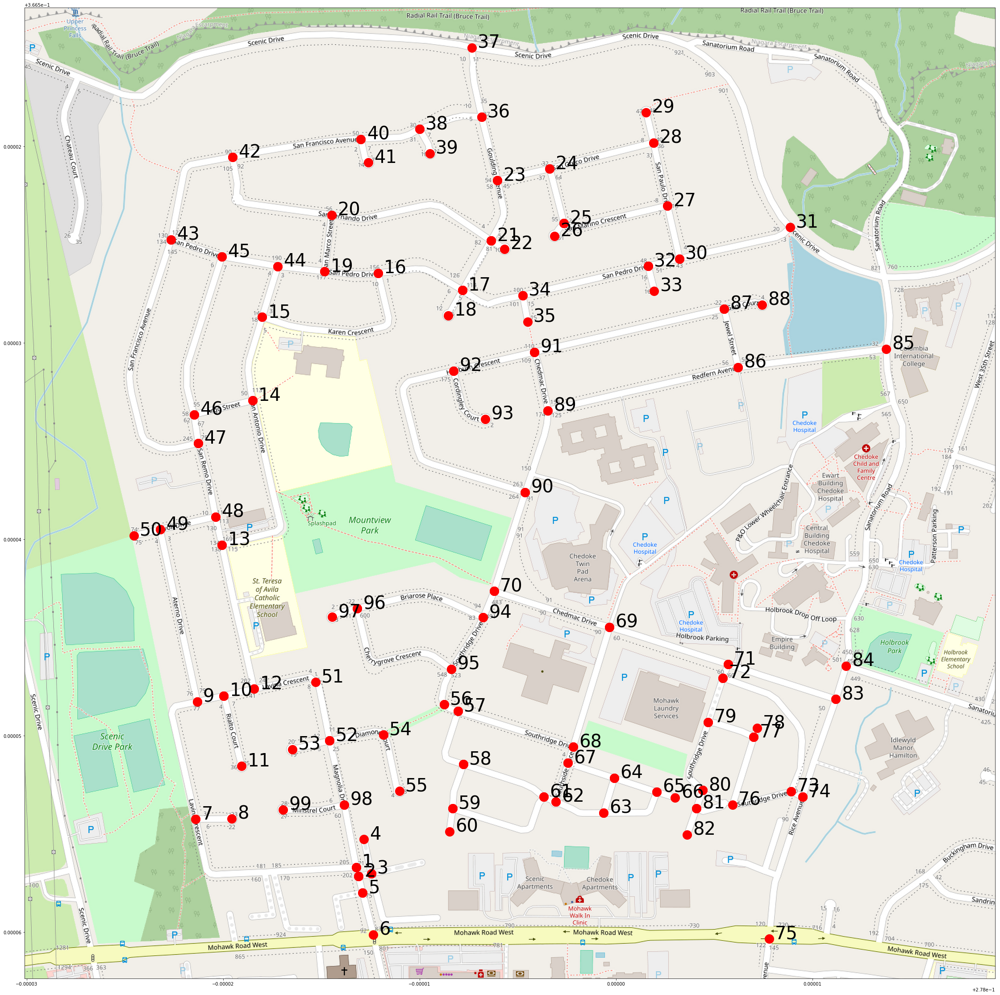

In [39]:
circuit_df, circuit, way_segments = get_cpp_circuit(mountview_query, mountview_starting_node)
draw_circuit(circuit_df, r'C:\tmp\mountview1.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\mountview1.gpx')

got back 329 nodes and 15 ways
20317532
27894159
189396037
189396046
281458430
281458431
281458432
281458516
281458517
281458518
281458519
533269051
533269052
533269054
581402690
node_to_ways
206382600 [20317532]
206382602 [20317532]
206382603 [20317532]
206382604 [20317532, 27894159, 189396046]
206382605 [189396037, 189396046]
206382606 [189396046]
206382607 [189396046, 581402690]
206382608 [189396046]
206382610 [189396046]
206382611 [189396046]
206382612 [189396046]
206382613 [189396046]
206382614 [189396046]
206382615 [189396046]
215683885 [20317532]
215683888 [20317532]
215683890 [20317532]
215684704 [20317532]
306221378 [189396046]
306262293 [27894159]
306262295 [27894159]
306262297 [27894159]
306262298 [27894159]
306262300 [27894159]
306262301 [27894159]
306262302 [27894159]
306262303 [27894159]
306262305 [27894159]
306262306 [27894159]
306262308 [27894159]
306262310 [27894159]
306262311 [27894159]
306262312 [27894159]
306262313 [27894159]
306262315 [27894159]
306262316 [27894159

INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48039.png


total_distance:11.242475384694032


INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48040.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48041.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48042.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48043.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48044.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48045.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36427/48046.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36428/48039.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36428/48040.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36428/48041.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36428/48042.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org

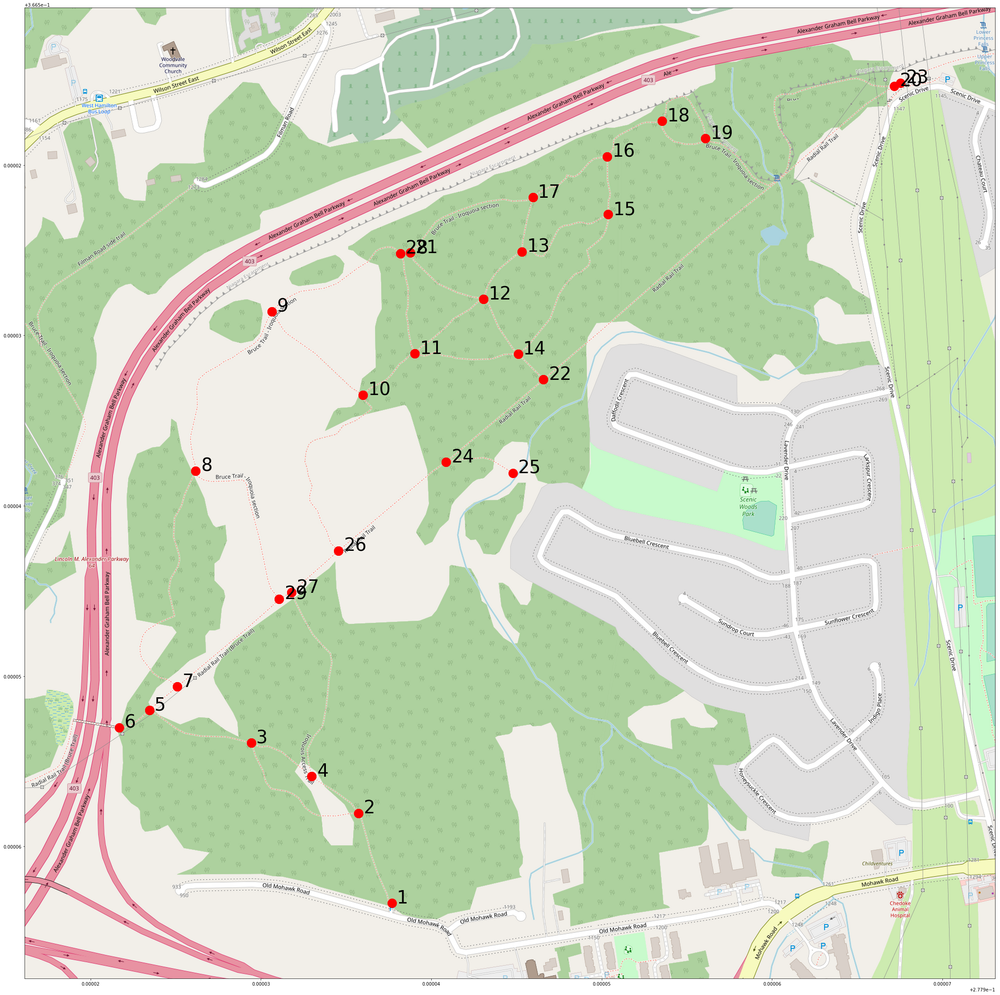

In [82]:
circuit_df, circuit, way_segments = get_cpp_circuit(iroquois_height_query, iroquois_starting_node)
draw_circuit(circuit_df, r'C:\tmp\iroquois_heights.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\iroquois_heights.gpx')

got back 4112 nodes and 269 ways
7947221
19804088
19817274
20317505
20317532
20360761
22728999
23842147
27894159
41161210
41161216
41161335
41161349
41161440
50525779
50525780
51535869
64746409
98080876
98081237
98081332
98086036
98086681
100946570
100946622
100948704
100948705
100948706
100948708
100948710
100948712
100948716
100948717
100948720
100948721
100948722
100948723
100948724
100948725
124796048
148998895
171478327
172096479
172096483
172096488
173774327
173833508
174792858
174792859
174792860
174792861
174797556
174797557
174797558
174797559
174797560
174861490
174861491
177043250
177212156
177212157
177776961
178208755
178677724
179483192
179484875
179485372
179485373
179779469
179779470
179779471
179779472
179779473
179779474
179780233
183363902
183363904
183366589
183366590
183366593
183366594
183367192
183367193
183367194
185811962
188215385
188215533
188353799
189396035
189396041
189396050
194402106
194402107
194402108
194402109
194432391
194432392
194434746
197752593
1

658938750 [249021853]
658938751 [249021853]
658938752 [249021853]
658938753 [249021853]
658938754 [249021853]
658938756 [249021853]
658938757 [249021853]
658938758 [249021853]
658938759 [249021853]
658938760 [249021853]
658938761 [249021853]
658938762 [249021853]
658938763 [249021853]
658938764 [249021853]
658938765 [249021853]
658938766 [249021853]
658938767 [249021853]
658938768 [249021853]
658938769 [249021853]
658938770 [249021853]
658938771 [249021853]
658938772 [173833508, 249021853]
658938773 [249021853]
658938774 [249021853]
658938775 [249021853]
658939655 [249021853]
658939656 [249021853]
660890768 [172096483]
660892546 [194432392]
784586562 [41161349, 148998895]
784587416 [148998895]
784590968 [41161216, 41161335]
784592661 [41161210, 41161216]
794402338 [64746409]
794402343 [64746409]
794402348 [64746409]
794402352 [64746409]
794431774 [254352263]
826769832 [183366594]
907776461 [301418559]
907778178 [174792861]
1135010963 [301418560]
1135011771 [23842147]
1135013260 [980812

1902178219 [179779470]
1902178221 [179779473]
1902178223 [179779470]
1902178225 [179779473]
1902178229 [179779469]
1902178231 [179779473]
1902178232 [179779469]
1902178234 [179779474]
1902178236 [179779474]
1902178239 [179779474]
1902178252 [179779473]
1902178253 [179779473]
1902178254 [179779473]
1902178255 [172096483]
1902178257 [179779471]
1902178258 [179779470]
1902178259 [179779473]
1902178260 [179779473]
1902190161 [248315310]
1902190162 [248315310]
1902645760 [249021853]
1902645761 [249021853]
1902645762 [194434746]
1902645763 [249021853]
1902645767 [51535869]
1902645769 [51535869, 249021853]
1902645779 [254352264]
1902645799 [254352264]
1902645835 [254352264]
1902645837 [194402107, 254352264]
1902645843 [254352264]
1902645853 [254352264]
1902645868 [249021853]
1902645872 [254352264]
1902645875 [23842147]
1902645878 [249021853]
1906427090 [174792858]
1906427094 [174792858]
1906427095 [174792859, 174792860]
1906429036 [174792858]
1906429038 [174792858]
1906429040 [174792858]
1906

2269712845 [217659156]
2269712846 [217659142]
2269712848 [217659158]
2269712850 [217659151]
2269712851 [217659156]
2269712853 [217659154]
2269712854 [217659152]
2269712856 [217659150]
2269712857 [217659142]
2269712858 [217659156]
2269712859 [217659156]
2269712863 [217659150]
2269712864 [217659152]
2269712867 [217659150]
2269712868 [217659158]
2269712869 [217659152]
2269712870 [217659147]
2269712871 [217659150]
2269712872 [183366593, 217659158]
2269712873 [217659150]
2269712875 [217659152]
2269712876 [217659147]
2269712877 [217659152]
2269712879 [217659146]
2269712880 [217659152]
2269712881 [217659150]
2269712884 [217659140, 217659156]
2269712885 [217659152]
2269712887 [217659147, 217659151]
2269712888 [217659146]
2269712890 [217659147]
2269712892 [217659149]
2269712895 [217659150]
2269712897 [217659146]
2269712898 [217659156]
2269712900 [217659148]
2269712901 [217659148]
2269712902 [217659158]
2269712903 [217659149]
2269712905 [217659156]
2269712907 [217659152]
2269712908 [217659149]
2

2504460673 [243007134, 249021853]
2504460674 [243007134]
2504460676 [243007134]
2504460677 [243007134]
2504460679 [243007134]
2504460681 [243007134]
2504460683 [243007134]
2504460685 [243007134]
2504460687 [243007134]
2504460689 [243007134]
2504460691 [243007134]
2504460693 [243007134]
2504460695 [243007134]
2504460697 [243007134]
2504460699 [243007134]
2504460700 [243007134]
2504460701 [243007134]
2504460702 [243007134]
2504460703 [243007134]
2504460705 [243007134]
2504460707 [243007134]
2504460709 [189396035, 243007134]
2504460711 [243007136, 243007140]
2504460715 [243007143]
2504460720 [243007143]
2504460722 [243007140]
2504460724 [243007143]
2504460726 [243007136]
2504460728 [243007143]
2504461602 [366569242]
2504461603 [366569242]
2504461604 [366569242]
2504461605 [366569242]
2504461606 [366569242]
2504461607 [366569242]
2504461608 [366569242]
2504461609 [366569242]
2504461610 [366569242]
2504461611 [366569242]
2504461612 [366569242]
2504461613 [366569242]
2504461614 [366569242]
2

3202444400 [173774327]
3202444401 [173774327]
3202444402 [173774327]
3202444403 [173774327]
3202444404 [173774327]
3202444405 [173774327]
3202444406 [173774327]
3202444407 [173774327]
3202444408 [173774327]
3202444409 [173774327]
3202444410 [173774327]
3202444411 [173774327]
3202444412 [173774327]
3202444413 [173774327]
3202444414 [173774327]
3202444415 [173774327]
3202444416 [173774327]
3202444417 [173774327]
3202444418 [173774327]
3202444419 [173774327]
3202444420 [173774327]
3202444421 [173774327]
3202444422 [173774327]
3202444423 [173774327]
3202444424 [173774327]
3202444425 [173774327]
3202444426 [173774327]
3202444427 [173774327]
3202444428 [173774327]
3202444429 [173774327]
3202444430 [173774327]
3202444601 [217672420]
3202444602 [217672420]
3202444603 [217672420]
3202444604 [217672420]
3202444605 [217672420]
3202444606 [217672420]
3202444607 [217672420]
3202444608 [217672420]
3202444655 [217659139]
3202444656 [217659139]
3202444657 [217659139]
3202444658 [217659139]
3202444659 

4876685706 [41161210]
4876685707 [41161210]
4876685708 [41161210]
4876685709 [41161210]
4876685710 [41161210]
4876685711 [41161349]
4876685712 [41161349]
4876685713 [41161349]
4876685714 [41161349]
4876685715 [41161349]
4876685716 [41161349]
4876685717 [41161349]
4876685718 [41161349]
4876685719 [41161349]
4876685720 [41161349]
4876685721 [41161349]
4876685722 [41161349]
4876685723 [41161349]
4876685724 [41161349]
4876685725 [41161349]
4876685726 [41161349]
4876685727 [41161349]
4876685728 [41161349]
4876685729 [41161349]
4876685730 [41161349]
4876685731 [41161349]
4876685732 [41161349]
4876685733 [41161349]
4876685734 [41161349]
4876685735 [41161349]
4876685736 [41161349]
4876685737 [41161349]
4876685738 [41161349]
4876685739 [41161349]
4876685740 [41161349]
4876685741 [41161349]
4876685742 [41161349]
4876685743 [41161349]
4876685744 [41161349]
4876685745 [41161349]
4876685746 [41161349]
4876685747 [41161349]
4876685748 [41161349]
4876685749 [41161349]
4876685750 [41161349]
4876685751

way_id:243007217 first_id:2504461642 last_id:1854565342
way_id:243009219 first_id:2504488609 last_id:2504488634
way_id:243009220 first_id:2504488628 last_id:2504488622
way_id:243009221 first_id:5173823497 last_id:2504488650
way_id:243009404 first_id:2504491139 last_id:2504491147
way_id:244425265 first_id:2517429523 last_id:1962691020
way_id:248315310 first_id:2000243171 last_id:408485608
way_id:249021853 first_id:1902645769 last_id:487823101
way_id:254352263 first_id:2601422613 last_id:658938743
way_id:254352264 first_id:658937253 last_id:1902645837
way_id:256301137 first_id:1855130932 last_id:1855130943
way_id:257155262 first_id:2269712835 last_id:487830315
way_id:257155922 first_id:2627563537 last_id:487823357
way_id:257441658 first_id:1937401688 last_id:1937401672
way_id:259287847 first_id:2646582956 last_id:2646582956
way_id:259287857 first_id:2646582956 last_id:2646582922
way_id:259287860 first_id:2646582983 last_id:2646583011
way_id:259287861 first_id:2646582892 last_id:264658296

(217659149, 0) [487835174, 2623462615, 4857775066]
(217659149, 1) [4857775066, 3202444862, 1845316356, 1845316357, 3202444863, 3202444864, 1845316358, 2623462624, 1845316359, 2623462617, 1845316360, 3202444865, 3202444866, 2623462622, 1845316361, 2623462626, 1845316362, 2623462620, 1845316363, 2269712908, 2269712913, 2269712663, 2269712747, 2269712744, 2269712665, 2269712916, 2269712654, 2269712903, 2269712892, 2269712789, 2269712647, 2269712776, 2269712761, 2269712693]
(217659150, 0) [2269712737, 2269712912, 2269712748, 2269712873, 2269712949, 2269712895, 2269712711, 2269712924, 2269712766, 2269712643, 2269712641, 2269712937, 2269712932, 2269712951, 2269712952, 2269712856, 2269712871, 2269712696, 2269712678, 2269712863, 2269712867, 2269712771, 2269712881, 1937401575]
(217659151, 0) [2623454305, 2623454303]
(217659151, 1) [2623454303, 2269712818, 2269712821, 2269712816, 2269712850, 2269712786, 2269712822, 2269712700, 2269712957, 2269712685, 2269712887]
(217659151, 2) [2269712887, 19374

removing 233 unconnected nodes
     distance        lat1        lat2         lon1         lon2       node1  \
10   0.170767  43.2394438  43.2407316  -79.9751185  -79.9756152   258359162   
11   0.288511  43.2407316  43.2430510  -79.9756152  -79.9769320  4876685583   
12   0.070236  43.2430510  43.2435465  -79.9769320  -79.9774582   258359314   
13   0.342044  43.2435465  43.2463791  -79.9774582  -79.9779409   258359317   
14   0.058600  43.2463791  43.2465545  -79.9779409  -79.9785393   258359336   
15   0.033279  43.2465545  43.2463591  -79.9785393  -79.9788485  2269845649   
18   0.168694  43.2383552  43.2379260  -79.9993777  -80.0012280   487823246   
19   0.013292  43.2379260  43.2378600  -80.0012280  -80.0013648   784592661   
20   0.140067  43.2378600  43.2367315  -80.0013648  -80.0018497  1902178198   
21   0.192453  43.2367315  43.2352270  -80.0018497  -80.0023150  2504460617   
22   0.276922  43.2352270  43.2332970  -80.0023150  -80.0036290   784590968   
23   0.171340  43.233

INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12008.png


total_distance:84.73892727890991


INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12009.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12010.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12011.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12012.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9100/12013.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12008.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12009.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12010.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12011.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12012.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9101/12013.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/15/9102/12

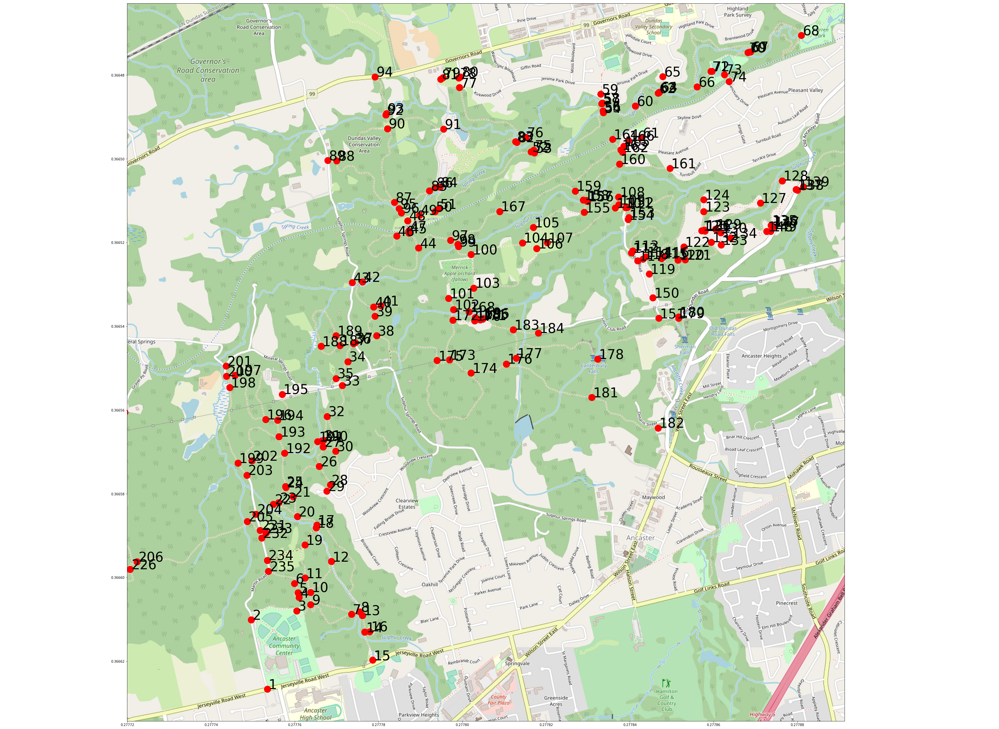

In [84]:
circuit_df, circuit, way_segments = get_cpp_circuit(dvca_query, dvca_starting_node)
draw_circuit(circuit_df, r'C:\tmp\dvca.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\dvca.gpx')

In [18]:
circuit_df, circuit, way_segments = get_cpp_circuit(sir_allen_query, sir_all_starting_point)
draw_circuit(circuit_df, r'C:\tmp\sir_allen.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\sir_allen.gpx')

got back 420 nodes and 43 ways
23810733
23810751
27210367
27210368
27258773
27258778
27258780
27258781
27258806
27258811
27258843
27258847
27258849
27258855
27258856
27258862
27258895
28284409
28284428
28514089
28514516
28514522
28514528
35289809
35293648
35293845
35294641
35295171
35299395
35299552
100763855
158120365
158120366
158120370
184331075
186398729
262613551
289590305
318893170
448424152
459926739
465327315
465664295
node_to_ways
35195044 [184331075]
35195047 [465327315]
35195052 [465664295]
35195053 [100763855, 448424152]
35195054 [28284409, 448424152]
60068013 [27258862]
258026228 [465327315]
258026229 [465327315]
258026230 [465327315]
258026231 [465327315]
258026232 [465327315]
258026233 [23810733, 465327315]
258026234 [27258856, 465327315]
258026235 [465327315]
258026236 [465327315]
258026237 [23810751, 465327315]
258026427 [23810733]
258026428 [23810733]
258026429 [23810733]
258026430 [23810733, 27258855]
258026431 [23810733, 27258849]
258026432 [23810733, 27258843]
2580

removing 22 unconnected nodes
    distance        lat1        lat2         lon1         lon2       node1  \
0   0.163456  43.2285829  43.2294071  -79.9220405  -79.9205342   258026233   
1   0.131044  43.2294071  43.2298886  -79.9205342  -79.9190579   258026430   
2   0.088642  43.2298886  43.2302326  -79.9190579  -79.9180709   258026431   
3   0.036802  43.2302326  43.2303576  -79.9180709  -79.9176503   258026432   
4   0.124543  43.2303576  43.2303775  -79.9176503  -79.9161478   258026433   
5   0.175874  43.2303775  43.2298547  -79.9161478  -79.9140990   258026438   
6   0.419191  43.2325600  43.2326413  -79.9241129  -79.9189459   258026650   
7   0.128366  43.2326413  43.2324933  -79.9189459  -79.9173745   258026725   
8   0.154728  43.2324933  43.2316999  -79.9173745  -79.9160532   258026726   
9   0.038998  43.2316999  43.2313783  -79.9160532  -79.9158630   258026731   
10  0.115615  43.2313783  43.2303775  -79.9158630  -79.9161478  1703759396   
11  0.079818  43.2303775  43.22969

AttributeError: 'set' object has no attribute 'items'

got back 637 nodes and 104 ways
4969981
8034924
8034941
20252185
20252372
20252436
20252469
23810751
24856807
25697005
25808576
25808603
26781999
27258847
27726852
27925283
27925290
27925295
27925296
27925297
27925298
27925302
27925306
28246672
28246689
28246690
28248678
28248698
28248732
28249201
28249536
28249616
28249675
28249769
28284303
28284316
28284330
28284349
28284428
28284469
35291087
35291978
35292007
35292438
35292815
35293200
35294180
35295258
35295905
35296169
35297788
35298330
35298343
35298961
35298973
35298987
35300020
35300392
35301152
54674395
54674405
54674411
54674480
54674481
54738876
54738897
54738911
54738920
54738926
54738936
54739501
100763855
158120365
158120366
158120370
182896956
262613496
262613498
262613554
299675995
362854937
367178874
375156596
375156597
375156613
377392508
379816730
435213732
435213736
435213739
438189702
438189804
448424152
448424153
459926738
465327306
465327307
465327309
465328794
465664297
476652860
476652861
476652862
506156426
no

way_id:8034941 first_id:214327119 last_id:60068039
way_id:20252185 first_id:214327119 last_id:60068008
way_id:20252372 first_id:214329528 last_id:214329542
way_id:20252436 first_id:214330695 last_id:60068039
way_id:20252469 first_id:214331119 last_id:214331120
way_id:23810751 first_id:258026650 last_id:258026237
way_id:24856807 first_id:60068010 last_id:31934490
way_id:25697005 first_id:293764469 last_id:293764471
way_id:25808576 first_id:293765904 last_id:310253709
way_id:25808603 first_id:3671027573 last_id:60067126
way_id:26781999 first_id:293765904 last_id:293765019
way_id:27258847 first_id:299181162 last_id:258026731
way_id:27726852 first_id:60068011 last_id:224348259
way_id:27925283 first_id:310609538 last_id:310232802
way_id:27925290 first_id:306532299 last_id:1722442393
way_id:27925295 first_id:293765017 last_id:306532310
way_id:27925296 first_id:306532356 last_id:293765020
way_id:27925297 first_id:293765022 last_id:306532319
way_id:27925298 first_id:306532325 last_id:293765021

removing 51 unconnected nodes
     distance        lat1        lat2         lon1         lon2       node1  \
0    0.050942  43.2418349  43.2417189  -79.8997803  -79.8991724   214327119   
1    0.088291  43.2417189  43.2414473  -79.8991724  -79.8981484    32924079   
2    0.081575  43.2414473  43.2411755  -79.8981484  -79.8972130    32924082   
3    0.151540  43.2438344  43.2425366  -79.9068978  -79.9074688    60068008   
4    0.211148  43.2425366  43.2407274  -79.9074688  -79.9082605    60068009   
5    0.211062  43.2407274  43.2389291  -79.9082605  -79.9090943   293765656   
6    0.172659  43.2389291  43.2374419  -79.9090943  -79.9097071    60068010   
7    0.171892  43.2374419  43.2359772  -79.9097071  -79.9103856   310232754   
8    0.125479  43.2359772  43.2349058  -79.9103856  -79.9108719    60068011   
9    0.041965  43.2349058  43.2345492  -79.9108719  -79.9110415   310606764   
10   0.164938  43.2418349  43.2428001  -79.8997803  -79.8984260   214327119   
11   0.218136  43.2418

INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36438/48038.png


total_distance:29.207213230038544


INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36439/48038.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36440/48038.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48038.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48039.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48040.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48041.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48042.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48043.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48044.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48045.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36441/48046.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org

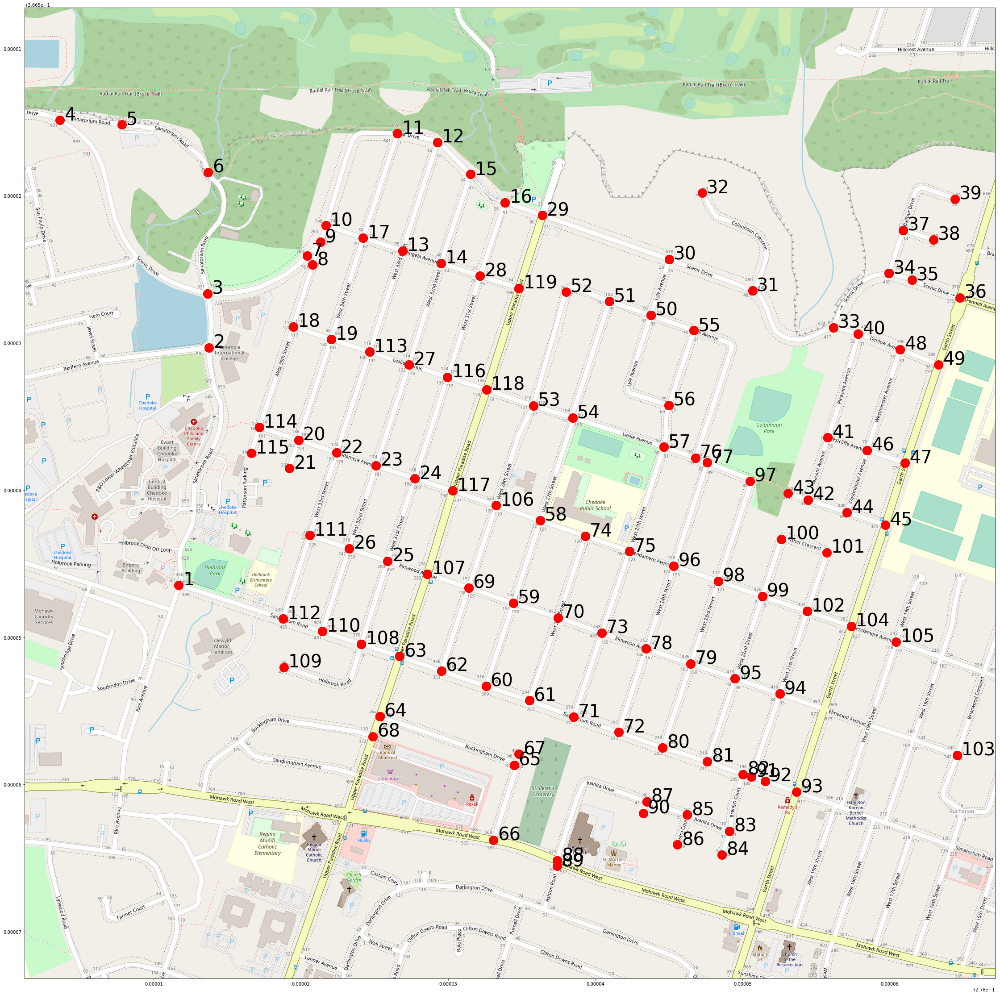

In [15]:
circuit_df, circuit, way_segments = get_cpp_circuit(west_query, west_starting_point)
draw_circuit(circuit_df, r'C:\tmp\west.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\west.gpx')

got back 443 nodes and 74 ways
28514088
28514089
28514516
28514522
28514528
28514606
28514754
35289213
35289285
35289364
35289768
35289808
35290314
35290449
35290662
35290913
35291301
35291430
35291594
35291599
35291609
35292282
35292781
35293262
35293349
35293524
35293648
35293845
35294053
35294224
35294296
35294555
35294641
35294679
35295129
35295171
35295284
35295380
35295541
35295740
35296682
35296818
35296934
35297164
35297261
35297505
35297908
35298603
35298658
35298852
35298870
35299395
35299552
35299611
35299886
35300205
35300316
35300635
100763884
100763885
100763886
158460354
158460356
186245436
186245438
186398729
186398730
260043318
260043319
260043321
289590305
465328797
465328798
465677858
node_to_ways
59197590 [28514754]
60068016 [35296934]
259667037 [28514088, 28514089, 186245438]
299182061 [186398729, 289590305]
313217533 [28514088]
313217534 [28514088, 28514754]
313217535 [28514088]
313217537 [28514088]
313217539 [28514088]
313217541 [28514088]
313217543 [28514088]
31

removing 0 unconnected nodes
    distance        lat1        lat2         lon1         lon2       node1  \
0   0.082840  43.2206447  43.2204265  -79.9241068  -79.9231293   259667037   
1   0.131735  43.2204265  43.2200416  -79.9231293  -79.9215918  2271256390   
2   0.196010  43.2200416  43.2210670  -79.9215918  -79.9200455   313217534   
3   0.052632  43.2286740  43.2282020  -79.9284150  -79.9284437   313217561   
4   0.159197  43.2282020  43.2267770  -79.9284437  -79.9282863   313217564   
5   0.200792  43.2267770  43.2249825  -79.9282863  -79.9280099   313217571   
6   0.120259  43.2249825  43.2239086  -79.9280099  -79.9278341   313217573   
7   0.249019  43.2239086  43.2219069  -79.9278341  -79.9265117  1934898688   
8   0.080558  43.2219069  43.2213188  -79.9265117  -79.9259311  1164616770   
9   0.169889  43.2213188  43.2206447  -79.9259311  -79.9241068  1970792364   
10  0.192325  43.2272820  43.2282020  -79.9294259  -79.9284437   313222585   
11  0.051286  43.2278782  43.228031

INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48047.png


total_distance:16.277730354265323


INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48048.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48049.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48050.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48051.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48052.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36433/48053.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36434/48047.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36434/48048.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36434/48049.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36434/48050.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org/17/36434/48051.png
INFO:tilemapbase.tiles:Requesting http://a.tile.openstreetmap.org

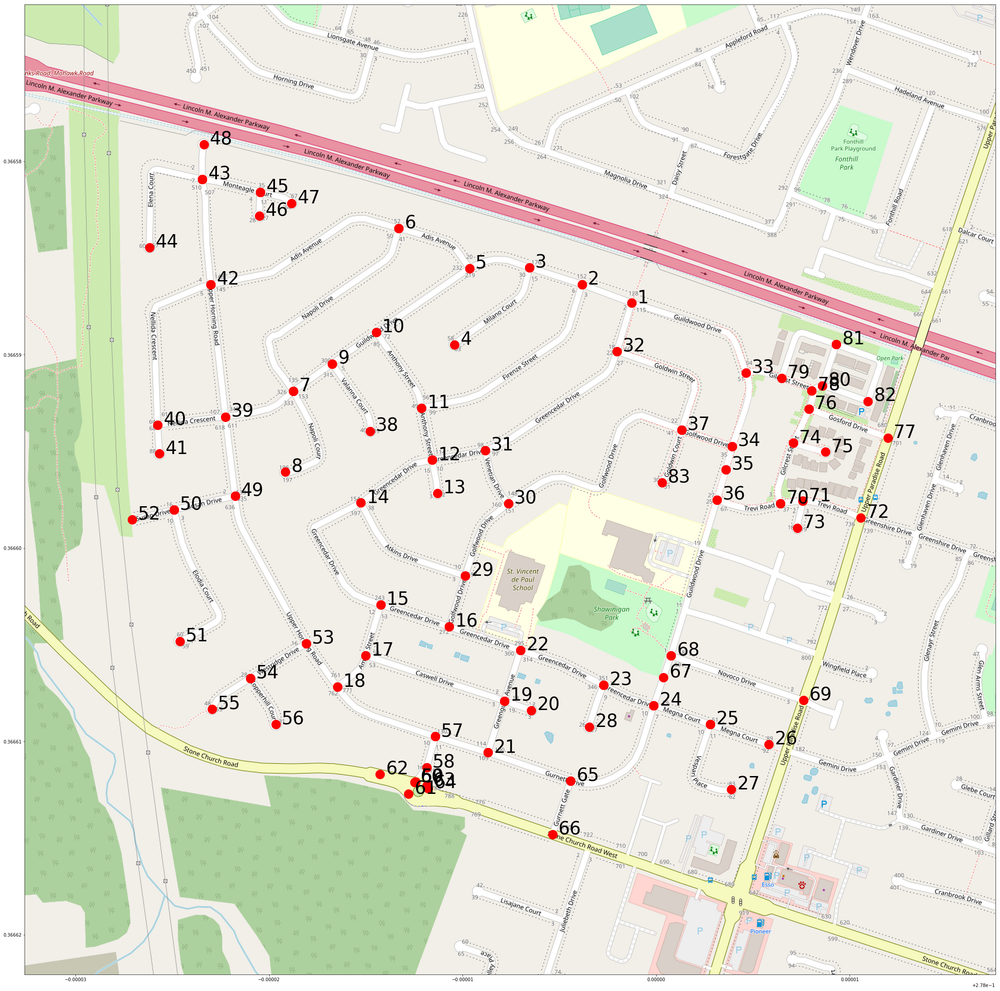

In [20]:
circuit_df, circuit, way_segments = get_cpp_circuit(gurnett_query, gurnett_start)
draw_circuit(circuit_df, r'C:\tmp\gurnett.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\gurnett.gpx')

got back 91 nodes and 15 ways
25808576
27726852
27925283
28248678
28248698
28248732
28249201
28249536
28249616
28249675
28249769
476652860
476652861
476652862
506156426
node_to_ways
60068008 [476652862]
60068009 [28249616]
60068010 [506156426]
60068011 [27726852]
90412358 [476652862]
90412359 [28248678, 476652862]
90412361 [476652862]
90412363 [476652862]
90412364 [28248698, 476652862]
90412367 [476652862]
90412368 [28248732, 476652862]
90412370 [476652862]
90412373 [476652862]
90412374 [28249201, 476652862]
90412377 [476652862]
90412378 [476652862]
90412379 [476652862]
90412381 [476652862]
90412382 [476652862]
90412384 [476652862]
90412385 [28249616, 476652862]
90412386 [28249675, 476652861, 476652862]
90412387 [476652861]
90412389 [476652860, 476652861]
224348259 [27726852]
293764471 [25808576]
293765656 [25808576]
293765658 [25808576]
293765659 [25808576]
293765904 [25808576]
293766081 [27925283]
304468629 [27726852, 28248678, 28249769]
304468630 [27726852, 28248698]
304468631 [2772

total_distance:12.388916105683009


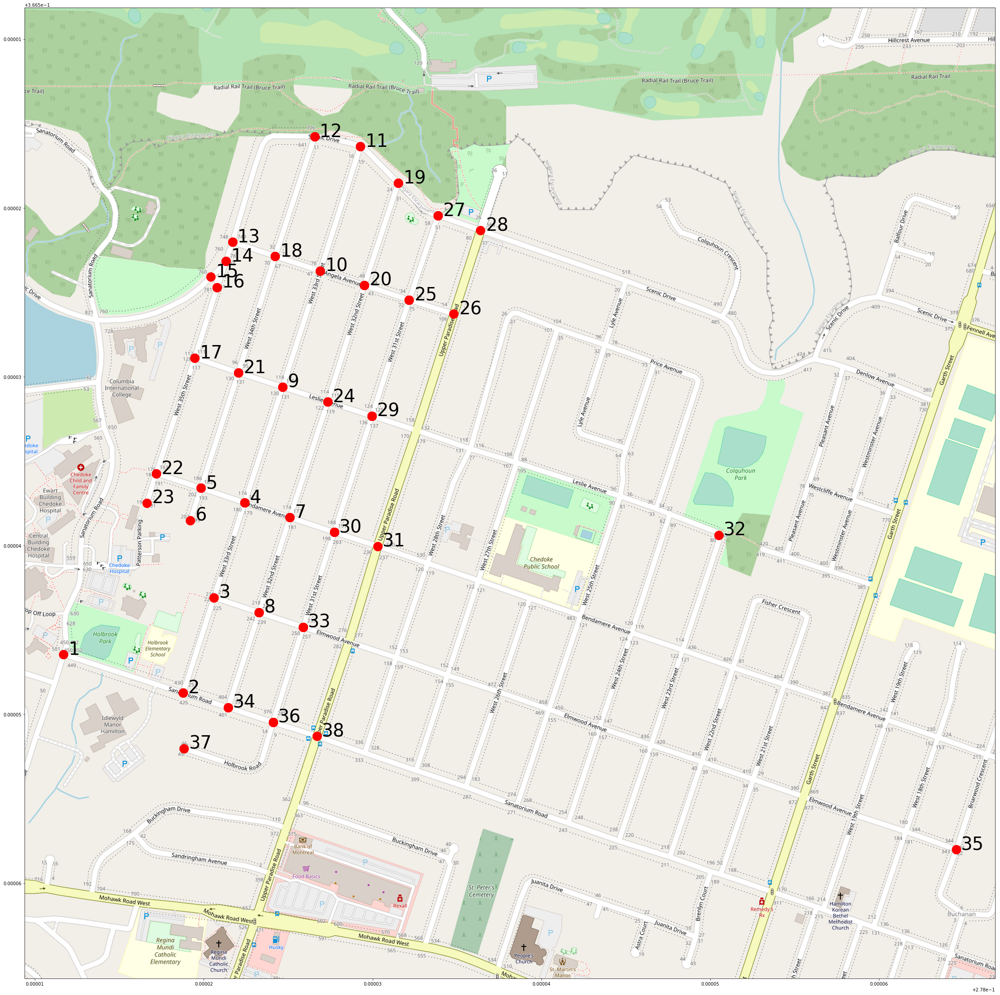

In [22]:
circuit_df, circuit, way_segments = get_cpp_circuit(west1_query, west1_start)
draw_circuit(circuit_df, r'C:\tmp\west1.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\west1.gpx')

got back 149 nodes and 32 ways
20879447
27828833
27828845
27828852
27828854
27828859
35290688
35291715
35292007
35292066
35293200
35295016
35295772
35295864
35296361
35296547
35297805
35298562
35299090
35299602
35299805
100763473
100763474
100763547
100763549
100763560
100763562
155378573
155378767
465327306
465327307
465327308
node_to_ways
35195052 [465327307]
224343103 [20879447, 465327307, 465327308]
224348259 [20879447, 465327306]
224348261 [465327307]
224348262 [465327307]
224348264 [465327307]
304468632 [465327306]
304468633 [465327306]
304468634 [465327306]
304468635 [465327306]
304468636 [465327306]
304468637 [465327306]
304468638 [465327306]
304468639 [465327306]
304468640 [465327306]
304468641 [465327306]
304468642 [465327306]
304468643 [465327306]
304468644 [465327306]
304468645 [465327306]
304468646 [465327306]
304468647 [465327306]
304468648 [465327306]
304468649 [465327306]
304468650 [465327306]
304468651 [465327306]
304468652 [27828859, 465327306]
305547671 [27828859, 15

total_distance:7.118132804701398


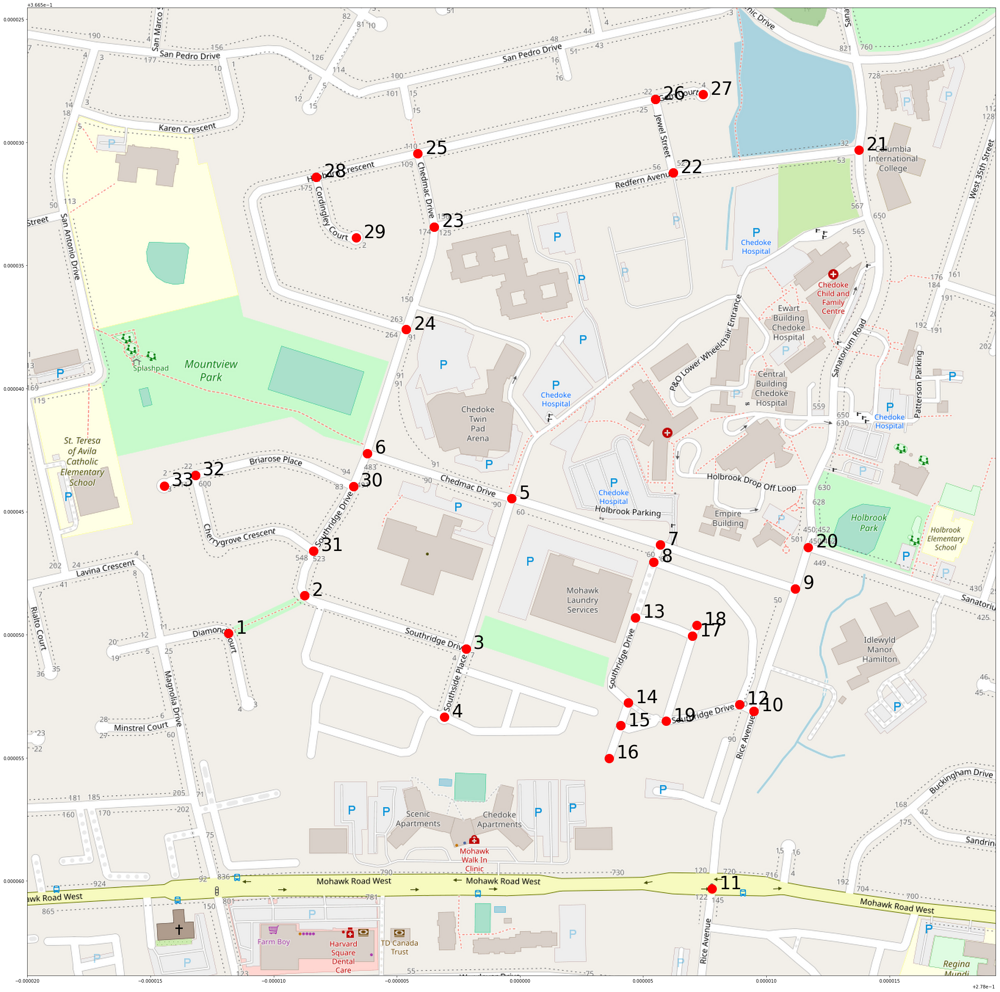

In [24]:
circuit_df, circuit, way_segments = get_cpp_circuit(mount2_query, mount2_start)
draw_circuit(circuit_df, r'C:\tmp\mount2.jpg')
generate_gpx(circuit, way_segments, r'C:\tmp\mount2.gpx')